# **Pre-trained ResNet-50 model trained on the KDEF dataset with input image resolution of 112x112.**

In [12]:
!pip install tensorboardX

In [13]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import time
from torch.utils.data import Dataset
import os
import copy
from tensorboardX import SummaryWriter
from PIL import Image
import torchvision.transforms as transforms
import random
plt.ion()   # interactive mode
%matplotlib inline

In [14]:
# Set fixed seed for reproducibility
seed = 42
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

In [15]:
from zipfile import ZipFile
import os

zip_path = '/content/KEDF_downsample_112x112.zip'

extract_to = '/content'

os.makedirs(extract_to, exist_ok=True)

with ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to)

print(f'✅ Files extracted to: {extract_to}')

✅ Files extracted to: /content


In [16]:
import os

classes = {
    "AF": 0, "AN": 1, "DI": 2, "HA": 3, "NE": 4, "SA": 5, "SU": 6
}

root='/content/KEDF_downsample_112x112'
invalid_files = []

for path, subdirs, files in os.walk(root):
    for name in files:
        if len(name) >= 6:
            emotion_code = name[4:6]
            if emotion_code not in classes:
                invalid_files.append(os.path.join(path, name))

# Print the problematic files
print("Found {} problematic files:".format(len(invalid_files)))
for file in invalid_files:
    print(file)

Found 0 problematic files:


In [17]:
class KDEFDataset(Dataset):
    def __init__(self, root='/content/KEDF_downsample_112x112', transforms_=None, idx=[]):
        self.transform = transforms_
        self.files = []

        for path, subdirs, files in os.walk(root):
            for name in files:
                self.files.append(os.path.join(path, name))

        self.files =  [self.files[i] for i in idx]
        self.classes = {
             "AF":0,
             "AN":1,
             "DI":2,
             "HA":3,
             "NE":4,
             "SA":5,
             "SU":6
        }
        for f in self.files:
          name = f.split('/')[-1]
          emotion_code = name[4:6]
          if emotion_code not in self.classes:
              print(f"Invalid file: {f} (code: {emotion_code})")

        for index in range(4900):
            filepath = self.files[index % len(self.files)]
            filename = filepath.split('/')[-1]
            if filename[4:6] not in self.classes:
                print(filepath)

    def __getitem__(self, index):
        filepath = self.files[index % len(self.files)]

        filename = filepath.split('/')[-1]
        img = self.transform(Image.open(filepath))
        label = self.classes[filename[4:6]]

        return img, label

    def __len__(self):
        return len(self.files)

Load Data
---------


In [18]:
data_transforms = {
    'train': transforms.Compose([
        transforms.Resize(224),
        transforms.CenterCrop(224),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
    ]),
    'val': transforms.Compose([
        transforms.Resize(224),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
    ]),
}

idx = np.random.permutation(4900)
idx = {'val': idx[0:490], 'train': idx[490:]}

g = torch.Generator()
g.manual_seed(42)

dataloaders = {
    x: torch.utils.data.DataLoader(
        KDEFDataset(transforms_=data_transforms[x], idx=idx[x]),
        batch_size=32,
        shuffle=True,
        generator=g
    )
    for x in ['train', 'val']
}

dataset_sizes = {x: len(idx[x]) for x in ['train', 'val']}
class_names = 7

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Visualize a few images


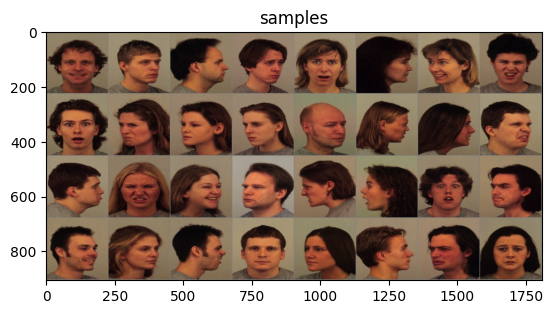

In [19]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.5, 0.5, 0.5])
    std = np.array([0.5, 0.5, 0.5])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated


# Get a batch of training data
inputs, classes = next(iter(dataloaders['train']))

# Make a grid from batch
out = torchvision.utils.make_grid(inputs)

imshow(out, title='samples')

Training the model
------------------

Now, let's write a general function to train a model. Here, we will
illustrate:

-  Scheduling the learning rate
-  Saving the best model

In the following, parameter ``scheduler`` is an LR scheduler object from
``torch.optim.lr_scheduler``.



In [20]:
from tqdm import tqdm

def train_model(model, criterion, optimizer, scheduler, dataloaders, writer=None, i=0,  num_epochs=25):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                scheduler.step()
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in tqdm(dataloaders[phase]):
                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))


            writer.add_scalar(phase+"/loss", epoch_loss, epoch)
            writer.add_scalar(phase+"/acc", epoch_acc, epoch)


            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())
                torch.save(model.state_dict(), 'saved/resnet_'+str(i)+'.pt')

        print()


    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, best_acc

Visualizing the model predictions

In [21]:
import imageio
import os
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

def visualize_model_misclassified(model, dataloader, class_names, save_dir='misclassified', num_images=15, columns=3):
    os.makedirs(save_dir, exist_ok=True)
    was_training = model.training
    model.eval()
    images_so_far = 0
    rows = (num_images + columns - 1) // columns
    fig, axes = plt.subplots(rows, columns, figsize=(columns * 4, rows * 4))
    axes = axes.flatten()

    with torch.no_grad():
        for inputs, labels in dataloader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                if preds[j] != labels[j]:
                    if images_so_far >= num_images:
                        break

                    # --- Display in grid ---
                    ax = axes[images_so_far]
                    ax.axis('off')
                    ax.set_title(f'Pred: {class_names[int(preds[j])]},\nTrue: {class_names[int(labels[j])]}', fontsize=9)
                    imshow(inputs.cpu().data[j], ax=ax)

                    # --- Save image with overlay text ---
                    img = inputs[j].cpu().numpy().transpose(1, 2, 0)
                    img = (img * 0.5 + 0.5) * 255
                    img = img.astype(np.uint8)
                    img_pil = Image.fromarray(img)

                    draw = ImageDraw.Draw(img_pil)
                    font = ImageFont.load_default()
                    text = f'Predicted: {class_names[int(preds[j])]} | True: {class_names[int(labels[j])]}'
                    draw.rectangle([10, 10, 280, 25], fill=(255, 255, 255))
                    draw.text((10, 10), text, font=font, fill=(0, 0, 0))

                    img_pil.save(f'{save_dir}/misclassified_{images_so_far + 1}.jpg')

                    images_so_far += 1

    for k in range(images_so_far, len(axes)):
        axes[k].axis('off')

    plt.tight_layout()
    plt.show()
    model.train(mode=was_training)


def imshow(inp, ax=None, title=None):
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.5, 0.5, 0.5])
    std = np.array([0.5, 0.5, 0.5])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    if ax is None:
        plt.imshow(inp)
    else:
        ax.imshow(inp)
    if title is not None:
        ax.set_title(title)


Finetuning the convnet
----------------------

Load a pretrained model and reset final fully connected layer.




Epoch 0/19
----------


100%|██████████| 138/138 [00:13<00:00,  9.90it/s]


train Loss: 1.5525 Acc: 0.3934


100%|██████████| 16/16 [00:00<00:00, 16.25it/s]


val Loss: 1.1022 Acc: 0.5633

Epoch 1/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.52it/s]


train Loss: 0.6813 Acc: 0.7569


100%|██████████| 16/16 [00:01<00:00, 15.56it/s]


val Loss: 0.7186 Acc: 0.7061

Epoch 2/19
----------


100%|██████████| 138/138 [00:12<00:00, 10.66it/s]


train Loss: 0.3781 Acc: 0.8651


100%|██████████| 16/16 [00:00<00:00, 16.40it/s]


val Loss: 0.3970 Acc: 0.8469

Epoch 3/19
----------


100%|██████████| 138/138 [00:12<00:00, 10.69it/s]


train Loss: 0.2267 Acc: 0.9249


100%|██████████| 16/16 [00:00<00:00, 16.28it/s]


val Loss: 0.3812 Acc: 0.8735

Epoch 4/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.56it/s]


train Loss: 0.1580 Acc: 0.9478


100%|██████████| 16/16 [00:01<00:00, 15.88it/s]


val Loss: 0.3649 Acc: 0.8592

Epoch 5/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.56it/s]


train Loss: 0.0780 Acc: 0.9828


100%|██████████| 16/16 [00:00<00:00, 16.21it/s]


val Loss: 0.2153 Acc: 0.9224

Epoch 6/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.52it/s]


train Loss: 0.0639 Acc: 0.9825


100%|██████████| 16/16 [00:00<00:00, 16.22it/s]


val Loss: 0.2009 Acc: 0.9286

Epoch 7/19
----------


100%|██████████| 138/138 [00:12<00:00, 10.65it/s]


train Loss: 0.0588 Acc: 0.9859


100%|██████████| 16/16 [00:01<00:00, 15.97it/s]


val Loss: 0.1972 Acc: 0.9388

Epoch 8/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.59it/s]


train Loss: 0.0537 Acc: 0.9887


100%|██████████| 16/16 [00:01<00:00, 15.48it/s]


val Loss: 0.1998 Acc: 0.9347

Epoch 9/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.60it/s]


train Loss: 0.0526 Acc: 0.9880


100%|██████████| 16/16 [00:00<00:00, 16.37it/s]


val Loss: 0.2041 Acc: 0.9245

Epoch 10/19
----------


100%|██████████| 138/138 [00:12<00:00, 10.71it/s]


train Loss: 0.0420 Acc: 0.9925


100%|██████████| 16/16 [00:00<00:00, 16.36it/s]


val Loss: 0.2015 Acc: 0.9347

Epoch 11/19
----------


100%|██████████| 138/138 [00:12<00:00, 10.72it/s]


train Loss: 0.0383 Acc: 0.9909


100%|██████████| 16/16 [00:00<00:00, 16.22it/s]


val Loss: 0.2045 Acc: 0.9306

Epoch 12/19
----------


100%|██████████| 138/138 [00:12<00:00, 10.67it/s]


train Loss: 0.0427 Acc: 0.9923


100%|██████████| 16/16 [00:01<00:00, 15.52it/s]


val Loss: 0.1945 Acc: 0.9367

Epoch 13/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.52it/s]


train Loss: 0.0373 Acc: 0.9932


100%|██████████| 16/16 [00:00<00:00, 16.14it/s]


val Loss: 0.1942 Acc: 0.9388

Epoch 14/19
----------


100%|██████████| 138/138 [00:12<00:00, 10.62it/s]


train Loss: 0.0395 Acc: 0.9932


100%|██████████| 16/16 [00:00<00:00, 16.11it/s]


val Loss: 0.1945 Acc: 0.9367

Epoch 15/19
----------


100%|██████████| 138/138 [00:12<00:00, 10.72it/s]


train Loss: 0.0414 Acc: 0.9909


100%|██████████| 16/16 [00:00<00:00, 16.45it/s]


val Loss: 0.1995 Acc: 0.9265

Epoch 16/19
----------


100%|██████████| 138/138 [00:12<00:00, 10.73it/s]


train Loss: 0.0362 Acc: 0.9946


100%|██████████| 16/16 [00:01<00:00, 15.96it/s]


val Loss: 0.1924 Acc: 0.9327

Epoch 17/19
----------


100%|██████████| 138/138 [00:12<00:00, 10.65it/s]


train Loss: 0.0357 Acc: 0.9946


100%|██████████| 16/16 [00:01<00:00, 14.16it/s]


val Loss: 0.2087 Acc: 0.9204

Epoch 18/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.40it/s]


train Loss: 0.0422 Acc: 0.9927


100%|██████████| 16/16 [00:01<00:00, 15.84it/s]


val Loss: 0.2037 Acc: 0.9347

Epoch 19/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.51it/s]


train Loss: 0.0413 Acc: 0.9923


100%|██████████| 16/16 [00:01<00:00, 15.95it/s]


val Loss: 0.1992 Acc: 0.9286

Training complete in 4m 43s
Best val Acc: 0.938776
Showing misclassified examples for fold 0...


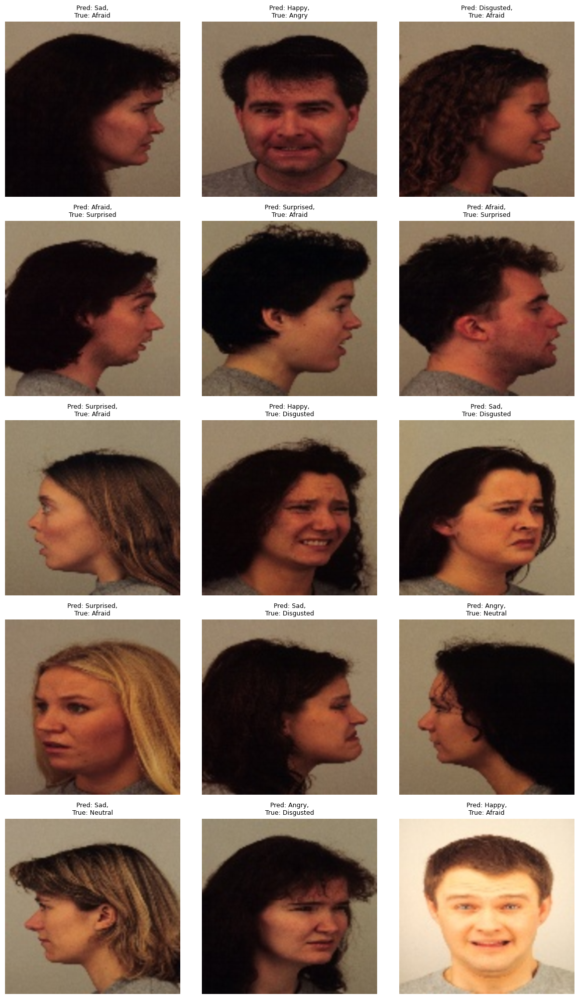




------------------------------------
 Accuracies  [0.9387755102040817]



Epoch 0/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.30it/s]


train Loss: 1.5998 Acc: 0.3667


100%|██████████| 16/16 [00:01<00:00, 15.49it/s]


val Loss: 1.0047 Acc: 0.6531

Epoch 1/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.42it/s]


train Loss: 0.6987 Acc: 0.7431


100%|██████████| 16/16 [00:01<00:00, 15.82it/s]


val Loss: 0.4655 Acc: 0.8327

Epoch 2/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.39it/s]


train Loss: 0.3631 Acc: 0.8760


100%|██████████| 16/16 [00:01<00:00, 15.70it/s]


val Loss: 0.4414 Acc: 0.8347

Epoch 3/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.37it/s]


train Loss: 0.2333 Acc: 0.9249


100%|██████████| 16/16 [00:01<00:00, 15.63it/s]


val Loss: 0.4829 Acc: 0.8347

Epoch 4/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.45it/s]


train Loss: 0.1687 Acc: 0.9451


100%|██████████| 16/16 [00:01<00:00, 15.30it/s]


val Loss: 0.3971 Acc: 0.8633

Epoch 5/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.43it/s]


train Loss: 0.0912 Acc: 0.9769


100%|██████████| 16/16 [00:01<00:00, 15.82it/s]


val Loss: 0.1788 Acc: 0.9347

Epoch 6/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.39it/s]


train Loss: 0.0672 Acc: 0.9855


100%|██████████| 16/16 [00:01<00:00, 15.95it/s]


val Loss: 0.1763 Acc: 0.9388

Epoch 7/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.24it/s]


train Loss: 0.0674 Acc: 0.9848


100%|██████████| 16/16 [00:01<00:00, 15.44it/s]


val Loss: 0.1615 Acc: 0.9449

Epoch 8/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.26it/s]


train Loss: 0.0538 Acc: 0.9889


100%|██████████| 16/16 [00:01<00:00, 15.23it/s]


val Loss: 0.1672 Acc: 0.9388

Epoch 9/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.45it/s]


train Loss: 0.0482 Acc: 0.9900


100%|██████████| 16/16 [00:01<00:00, 15.47it/s]


val Loss: 0.1626 Acc: 0.9429

Epoch 10/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.36it/s]


train Loss: 0.0478 Acc: 0.9884


100%|██████████| 16/16 [00:01<00:00, 15.81it/s]


val Loss: 0.1578 Acc: 0.9469

Epoch 11/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.16it/s]


train Loss: 0.0472 Acc: 0.9889


100%|██████████| 16/16 [00:01<00:00, 14.83it/s]


val Loss: 0.1594 Acc: 0.9449

Epoch 12/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.29it/s]


train Loss: 0.0440 Acc: 0.9923


100%|██████████| 16/16 [00:01<00:00, 15.74it/s]


val Loss: 0.1599 Acc: 0.9469

Epoch 13/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.42it/s]


train Loss: 0.0420 Acc: 0.9927


100%|██████████| 16/16 [00:01<00:00, 15.77it/s]


val Loss: 0.1658 Acc: 0.9429

Epoch 14/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.35it/s]


train Loss: 0.0423 Acc: 0.9927


100%|██████████| 16/16 [00:01<00:00, 15.74it/s]


val Loss: 0.1467 Acc: 0.9469

Epoch 15/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.42it/s]


train Loss: 0.0380 Acc: 0.9946


100%|██████████| 16/16 [00:01<00:00, 14.75it/s]


val Loss: 0.1602 Acc: 0.9449

Epoch 16/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.50it/s]


train Loss: 0.0415 Acc: 0.9923


100%|██████████| 16/16 [00:01<00:00, 15.82it/s]


val Loss: 0.1497 Acc: 0.9449

Epoch 17/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.44it/s]


train Loss: 0.0380 Acc: 0.9939


100%|██████████| 16/16 [00:01<00:00, 15.44it/s]


val Loss: 0.1552 Acc: 0.9429

Epoch 18/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.47it/s]


train Loss: 0.0425 Acc: 0.9934


100%|██████████| 16/16 [00:01<00:00, 15.43it/s]


val Loss: 0.1439 Acc: 0.9510

Epoch 19/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.36it/s]


train Loss: 0.0406 Acc: 0.9930


100%|██████████| 16/16 [00:01<00:00, 14.99it/s]


val Loss: 0.1708 Acc: 0.9449

Training complete in 4m 49s
Best val Acc: 0.951020
Showing misclassified examples for fold 1...


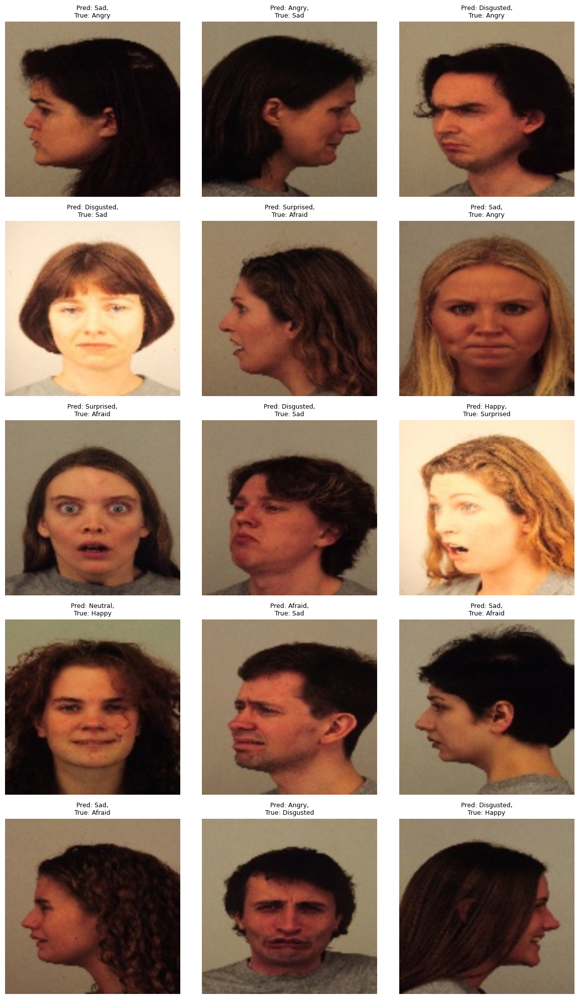




------------------------------------
 Accuracies  [0.9387755102040817, 0.9510204081632654]



Epoch 0/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.29it/s]


train Loss: 1.6109 Acc: 0.3624


100%|██████████| 16/16 [00:01<00:00, 14.98it/s]


val Loss: 1.0647 Acc: 0.5837

Epoch 1/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.29it/s]


train Loss: 0.7125 Acc: 0.7442


100%|██████████| 16/16 [00:01<00:00, 15.39it/s]


val Loss: 0.5268 Acc: 0.8122

Epoch 2/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.25it/s]


train Loss: 0.3964 Acc: 0.8569


100%|██████████| 16/16 [00:01<00:00, 15.32it/s]


val Loss: 0.4666 Acc: 0.8327

Epoch 3/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.32it/s]


train Loss: 0.2609 Acc: 0.9156


100%|██████████| 16/16 [00:01<00:00, 15.57it/s]


val Loss: 0.3408 Acc: 0.8878

Epoch 4/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.38it/s]


train Loss: 0.1662 Acc: 0.9469


100%|██████████| 16/16 [00:01<00:00, 15.65it/s]


val Loss: 0.3994 Acc: 0.8571

Epoch 5/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.48it/s]


train Loss: 0.1010 Acc: 0.9710


100%|██████████| 16/16 [00:00<00:00, 16.10it/s]


val Loss: 0.2400 Acc: 0.9102

Epoch 6/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.39it/s]


train Loss: 0.0739 Acc: 0.9816


100%|██████████| 16/16 [00:01<00:00, 15.06it/s]


val Loss: 0.2166 Acc: 0.9102

Epoch 7/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.12it/s]


train Loss: 0.0673 Acc: 0.9844


100%|██████████| 16/16 [00:01<00:00, 15.46it/s]


val Loss: 0.1961 Acc: 0.9265

Epoch 8/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.27it/s]


train Loss: 0.0553 Acc: 0.9884


100%|██████████| 16/16 [00:01<00:00, 15.71it/s]


val Loss: 0.2054 Acc: 0.9245

Epoch 9/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.42it/s]


train Loss: 0.0568 Acc: 0.9880


100%|██████████| 16/16 [00:01<00:00, 15.32it/s]


val Loss: 0.2011 Acc: 0.9224

Epoch 10/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.23it/s]


train Loss: 0.0503 Acc: 0.9889


100%|██████████| 16/16 [00:01<00:00, 15.67it/s]


val Loss: 0.1998 Acc: 0.9204

Epoch 11/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.35it/s]


train Loss: 0.0394 Acc: 0.9939


100%|██████████| 16/16 [00:01<00:00, 15.04it/s]


val Loss: 0.1938 Acc: 0.9347

Epoch 12/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.44it/s]


train Loss: 0.0394 Acc: 0.9946


100%|██████████| 16/16 [00:00<00:00, 16.20it/s]


val Loss: 0.2016 Acc: 0.9286

Epoch 13/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.38it/s]


train Loss: 0.0449 Acc: 0.9914


100%|██████████| 16/16 [00:01<00:00, 15.97it/s]


val Loss: 0.1906 Acc: 0.9245

Epoch 14/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.34it/s]


train Loss: 0.0446 Acc: 0.9907


100%|██████████| 16/16 [00:01<00:00, 15.66it/s]


val Loss: 0.1991 Acc: 0.9204

Epoch 15/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.23it/s]


train Loss: 0.0396 Acc: 0.9934


100%|██████████| 16/16 [00:01<00:00, 15.59it/s]


val Loss: 0.1923 Acc: 0.9347

Epoch 16/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.29it/s]


train Loss: 0.0417 Acc: 0.9923


100%|██████████| 16/16 [00:01<00:00, 15.00it/s]


val Loss: 0.1999 Acc: 0.9265

Epoch 17/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.22it/s]


train Loss: 0.0446 Acc: 0.9905


100%|██████████| 16/16 [00:01<00:00, 14.89it/s]


val Loss: 0.1992 Acc: 0.9224

Epoch 18/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.29it/s]


train Loss: 0.0410 Acc: 0.9916


100%|██████████| 16/16 [00:01<00:00, 15.30it/s]


val Loss: 0.2072 Acc: 0.9204

Epoch 19/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.45it/s]


train Loss: 0.0394 Acc: 0.9937


100%|██████████| 16/16 [00:01<00:00, 14.88it/s]


val Loss: 0.1855 Acc: 0.9306

Training complete in 4m 50s
Best val Acc: 0.934694
Showing misclassified examples for fold 2...


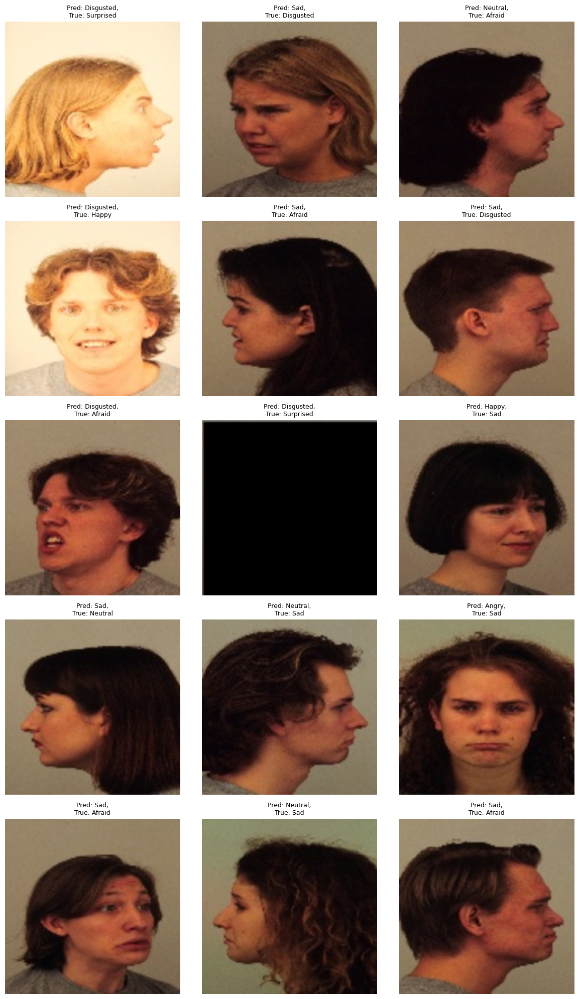




------------------------------------
 Accuracies  [0.9387755102040817, 0.9510204081632654, 0.9346938775510205]



Epoch 0/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.20it/s]


train Loss: 1.6055 Acc: 0.3823


100%|██████████| 16/16 [00:01<00:00, 15.28it/s]


val Loss: 0.9953 Acc: 0.6612

Epoch 1/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.29it/s]


train Loss: 0.6829 Acc: 0.7583


100%|██████████| 16/16 [00:01<00:00, 15.59it/s]


val Loss: 0.7521 Acc: 0.7327

Epoch 2/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.18it/s]


train Loss: 0.3863 Acc: 0.8644


100%|██████████| 16/16 [00:01<00:00, 15.23it/s]


val Loss: 0.4556 Acc: 0.8408

Epoch 3/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.25it/s]


train Loss: 0.2172 Acc: 0.9283


100%|██████████| 16/16 [00:01<00:00, 15.55it/s]


val Loss: 0.3422 Acc: 0.8816

Epoch 4/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.18it/s]


train Loss: 0.1599 Acc: 0.9483


100%|██████████| 16/16 [00:01<00:00, 15.36it/s]


val Loss: 0.2423 Acc: 0.9122

Epoch 5/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.29it/s]


train Loss: 0.0855 Acc: 0.9746


100%|██████████| 16/16 [00:01<00:00, 15.81it/s]


val Loss: 0.2247 Acc: 0.9082

Epoch 6/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.32it/s]


train Loss: 0.0689 Acc: 0.9816


100%|██████████| 16/16 [00:01<00:00, 15.82it/s]


val Loss: 0.2324 Acc: 0.9061

Epoch 7/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.30it/s]


train Loss: 0.0669 Acc: 0.9810


100%|██████████| 16/16 [00:01<00:00, 15.33it/s]


val Loss: 0.2346 Acc: 0.9143

Epoch 8/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.28it/s]


train Loss: 0.0568 Acc: 0.9873


100%|██████████| 16/16 [00:01<00:00, 14.94it/s]


val Loss: 0.2216 Acc: 0.9143

Epoch 9/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.21it/s]


train Loss: 0.0512 Acc: 0.9893


100%|██████████| 16/16 [00:01<00:00, 15.14it/s]


val Loss: 0.2213 Acc: 0.9102

Epoch 10/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.29it/s]


train Loss: 0.0507 Acc: 0.9887


100%|██████████| 16/16 [00:01<00:00, 15.79it/s]


val Loss: 0.2090 Acc: 0.9204

Epoch 11/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.18it/s]


train Loss: 0.0435 Acc: 0.9900


100%|██████████| 16/16 [00:01<00:00, 13.81it/s]


val Loss: 0.2124 Acc: 0.9224

Epoch 12/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.21it/s]


train Loss: 0.0402 Acc: 0.9923


100%|██████████| 16/16 [00:01<00:00, 15.15it/s]


val Loss: 0.2231 Acc: 0.9184

Epoch 13/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.37it/s]


train Loss: 0.0382 Acc: 0.9921


100%|██████████| 16/16 [00:01<00:00, 15.77it/s]


val Loss: 0.2205 Acc: 0.9163

Epoch 14/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.21it/s]


train Loss: 0.0477 Acc: 0.9893


100%|██████████| 16/16 [00:01<00:00, 15.37it/s]


val Loss: 0.2201 Acc: 0.9204

Epoch 15/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.24it/s]


train Loss: 0.0395 Acc: 0.9925


100%|██████████| 16/16 [00:01<00:00, 14.82it/s]


val Loss: 0.2341 Acc: 0.9102

Epoch 16/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.19it/s]


train Loss: 0.0410 Acc: 0.9912


100%|██████████| 16/16 [00:01<00:00, 15.39it/s]


val Loss: 0.2200 Acc: 0.9163

Epoch 17/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.25it/s]


train Loss: 0.0405 Acc: 0.9921


100%|██████████| 16/16 [00:01<00:00, 15.03it/s]


val Loss: 0.2367 Acc: 0.9061

Epoch 18/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.32it/s]


train Loss: 0.0355 Acc: 0.9950


100%|██████████| 16/16 [00:01<00:00, 15.82it/s]


val Loss: 0.2298 Acc: 0.9163

Epoch 19/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.26it/s]


train Loss: 0.0416 Acc: 0.9916


100%|██████████| 16/16 [00:01<00:00, 14.40it/s]


val Loss: 0.2199 Acc: 0.9122

Training complete in 4m 52s
Best val Acc: 0.922449
Showing misclassified examples for fold 3...


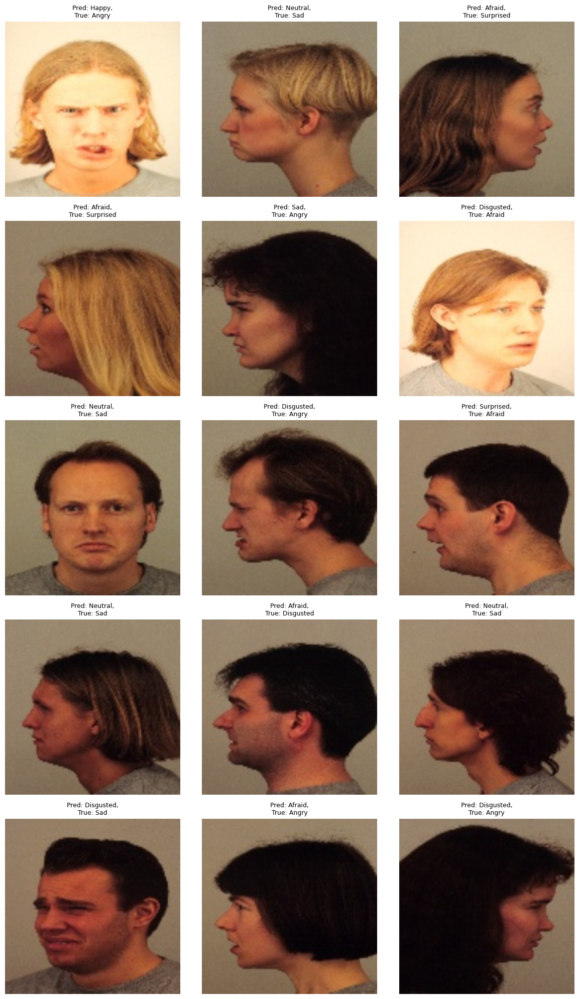




------------------------------------
 Accuracies  [0.9387755102040817, 0.9510204081632654, 0.9346938775510205, 0.9224489795918368]



Epoch 0/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.38it/s]


train Loss: 1.5979 Acc: 0.3615


100%|██████████| 16/16 [00:01<00:00, 15.95it/s]


val Loss: 0.9117 Acc: 0.6980

Epoch 1/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.30it/s]


train Loss: 0.6851 Acc: 0.7517


100%|██████████| 16/16 [00:01<00:00, 15.11it/s]


val Loss: 0.4692 Acc: 0.8286

Epoch 2/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.09it/s]


train Loss: 0.3739 Acc: 0.8707


100%|██████████| 16/16 [00:01<00:00, 15.28it/s]


val Loss: 0.3551 Acc: 0.8816

Epoch 3/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.25it/s]


train Loss: 0.2400 Acc: 0.9222


100%|██████████| 16/16 [00:01<00:00, 14.20it/s]


val Loss: 0.4714 Acc: 0.8286

Epoch 4/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.12it/s]


train Loss: 0.1871 Acc: 0.9385


100%|██████████| 16/16 [00:01<00:00, 15.85it/s]


val Loss: 0.2911 Acc: 0.8980

Epoch 5/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.16it/s]


train Loss: 0.1034 Acc: 0.9694


100%|██████████| 16/16 [00:01<00:00, 15.27it/s]


val Loss: 0.1693 Acc: 0.9531

Epoch 6/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.26it/s]


train Loss: 0.0764 Acc: 0.9814


100%|██████████| 16/16 [00:01<00:00, 15.26it/s]


val Loss: 0.1635 Acc: 0.9469

Epoch 7/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.33it/s]


train Loss: 0.0698 Acc: 0.9834


100%|██████████| 16/16 [00:01<00:00, 14.89it/s]


val Loss: 0.1593 Acc: 0.9469

Epoch 8/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.43it/s]


train Loss: 0.0616 Acc: 0.9846


100%|██████████| 16/16 [00:01<00:00, 15.17it/s]


val Loss: 0.1702 Acc: 0.9408

Epoch 9/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.35it/s]


train Loss: 0.0543 Acc: 0.9882


100%|██████████| 16/16 [00:01<00:00, 14.53it/s]


val Loss: 0.1593 Acc: 0.9429

Epoch 10/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.45it/s]


train Loss: 0.0474 Acc: 0.9900


100%|██████████| 16/16 [00:01<00:00, 15.42it/s]


val Loss: 0.1555 Acc: 0.9551

Epoch 11/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.39it/s]


train Loss: 0.0477 Acc: 0.9902


100%|██████████| 16/16 [00:01<00:00, 15.76it/s]


val Loss: 0.1562 Acc: 0.9490

Epoch 12/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.35it/s]


train Loss: 0.0444 Acc: 0.9902


100%|██████████| 16/16 [00:01<00:00, 15.10it/s]


val Loss: 0.1506 Acc: 0.9531

Epoch 13/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.41it/s]


train Loss: 0.0483 Acc: 0.9889


100%|██████████| 16/16 [00:01<00:00, 15.31it/s]


val Loss: 0.1542 Acc: 0.9510

Epoch 14/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.16it/s]


train Loss: 0.0442 Acc: 0.9918


100%|██████████| 16/16 [00:01<00:00, 15.41it/s]


val Loss: 0.1575 Acc: 0.9490

Epoch 15/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.12it/s]


train Loss: 0.0483 Acc: 0.9896


100%|██████████| 16/16 [00:01<00:00, 15.83it/s]


val Loss: 0.1492 Acc: 0.9490

Epoch 16/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.16it/s]


train Loss: 0.0439 Acc: 0.9912


100%|██████████| 16/16 [00:01<00:00, 15.87it/s]


val Loss: 0.1601 Acc: 0.9490

Epoch 17/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.23it/s]


train Loss: 0.0463 Acc: 0.9909


100%|██████████| 16/16 [00:01<00:00, 15.72it/s]


val Loss: 0.1500 Acc: 0.9490

Epoch 18/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.23it/s]


train Loss: 0.0488 Acc: 0.9900


100%|██████████| 16/16 [00:01<00:00, 15.72it/s]


val Loss: 0.1527 Acc: 0.9510

Epoch 19/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.24it/s]


train Loss: 0.0442 Acc: 0.9918


100%|██████████| 16/16 [00:01<00:00, 15.35it/s]


val Loss: 0.1504 Acc: 0.9490

Training complete in 4m 51s
Best val Acc: 0.955102
Showing misclassified examples for fold 4...


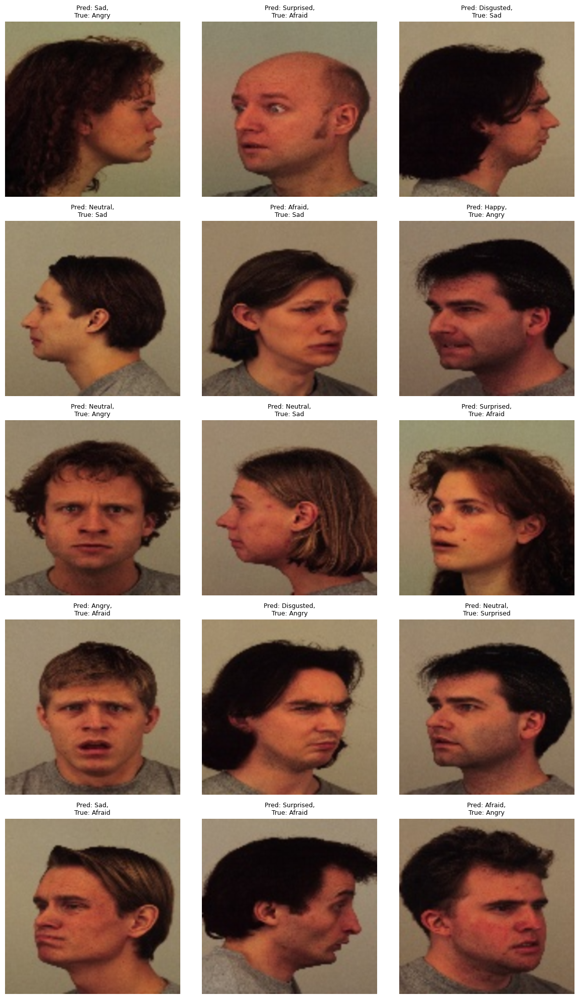




------------------------------------
 Accuracies  [0.9387755102040817, 0.9510204081632654, 0.9346938775510205, 0.9224489795918368, 0.9551020408163267]



Epoch 0/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.07it/s]


train Loss: 1.5969 Acc: 0.3683


100%|██████████| 16/16 [00:01<00:00, 15.88it/s]


val Loss: 0.9632 Acc: 0.6510

Epoch 1/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.31it/s]


train Loss: 0.7045 Acc: 0.7465


100%|██████████| 16/16 [00:01<00:00, 15.92it/s]


val Loss: 0.7380 Acc: 0.7327

Epoch 2/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.30it/s]


train Loss: 0.3805 Acc: 0.8683


100%|██████████| 16/16 [00:01<00:00, 15.44it/s]


val Loss: 0.5419 Acc: 0.8082

Epoch 3/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.11it/s]


train Loss: 0.2281 Acc: 0.9229


100%|██████████| 16/16 [00:01<00:00, 14.86it/s]


val Loss: 0.3002 Acc: 0.9000

Epoch 4/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.19it/s]


train Loss: 0.1572 Acc: 0.9517


100%|██████████| 16/16 [00:01<00:00, 14.68it/s]


val Loss: 0.3324 Acc: 0.8776

Epoch 5/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.27it/s]


train Loss: 0.0846 Acc: 0.9780


100%|██████████| 16/16 [00:01<00:00, 14.91it/s]


val Loss: 0.2103 Acc: 0.9367

Epoch 6/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.22it/s]


train Loss: 0.0716 Acc: 0.9825


100%|██████████| 16/16 [00:01<00:00, 14.97it/s]


val Loss: 0.2038 Acc: 0.9367

Epoch 7/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.21it/s]


train Loss: 0.0590 Acc: 0.9859


100%|██████████| 16/16 [00:01<00:00, 15.57it/s]


val Loss: 0.1999 Acc: 0.9408

Epoch 8/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.16it/s]


train Loss: 0.0565 Acc: 0.9866


100%|██████████| 16/16 [00:01<00:00, 15.49it/s]


val Loss: 0.2223 Acc: 0.9327

Epoch 9/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.22it/s]


train Loss: 0.0484 Acc: 0.9889


100%|██████████| 16/16 [00:01<00:00, 12.67it/s]


val Loss: 0.2011 Acc: 0.9388

Epoch 10/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.07it/s]


train Loss: 0.0486 Acc: 0.9900


100%|██████████| 16/16 [00:01<00:00, 14.94it/s]


val Loss: 0.1903 Acc: 0.9429

Epoch 11/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.14it/s]


train Loss: 0.0411 Acc: 0.9916


100%|██████████| 16/16 [00:01<00:00, 15.18it/s]


val Loss: 0.1911 Acc: 0.9388

Epoch 12/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.22it/s]


train Loss: 0.0384 Acc: 0.9930


100%|██████████| 16/16 [00:01<00:00, 15.51it/s]


val Loss: 0.1826 Acc: 0.9449

Epoch 13/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.24it/s]


train Loss: 0.0372 Acc: 0.9925


100%|██████████| 16/16 [00:01<00:00, 15.75it/s]


val Loss: 0.1951 Acc: 0.9429

Epoch 14/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.17it/s]


train Loss: 0.0406 Acc: 0.9923


100%|██████████| 16/16 [00:01<00:00, 15.59it/s]


val Loss: 0.1883 Acc: 0.9429

Epoch 15/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.15it/s]


train Loss: 0.0363 Acc: 0.9941


100%|██████████| 16/16 [00:01<00:00, 14.91it/s]


val Loss: 0.1927 Acc: 0.9429

Epoch 16/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.12it/s]


train Loss: 0.0398 Acc: 0.9921


100%|██████████| 16/16 [00:01<00:00, 15.01it/s]


val Loss: 0.1865 Acc: 0.9429

Epoch 17/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.20it/s]


train Loss: 0.0378 Acc: 0.9932


100%|██████████| 16/16 [00:01<00:00, 14.10it/s]


val Loss: 0.1925 Acc: 0.9449

Epoch 18/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.23it/s]


train Loss: 0.0415 Acc: 0.9912


100%|██████████| 16/16 [00:01<00:00, 15.71it/s]


val Loss: 0.1971 Acc: 0.9347

Epoch 19/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.09it/s]


train Loss: 0.0375 Acc: 0.9937


100%|██████████| 16/16 [00:01<00:00, 15.86it/s]


val Loss: 0.1999 Acc: 0.9367

Training complete in 4m 54s
Best val Acc: 0.944898
Showing misclassified examples for fold 5...


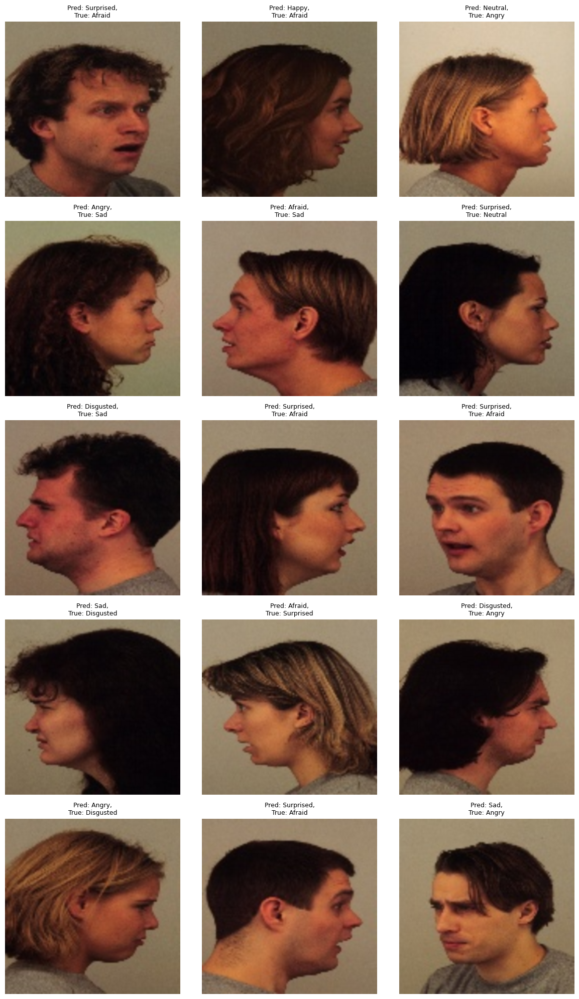




------------------------------------
 Accuracies  [0.9387755102040817, 0.9510204081632654, 0.9346938775510205, 0.9224489795918368, 0.9551020408163267, 0.9448979591836736]



Epoch 0/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.01it/s]


train Loss: 1.5740 Acc: 0.3912


100%|██████████| 16/16 [00:01<00:00, 15.34it/s]


val Loss: 0.9482 Acc: 0.6592

Epoch 1/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.00it/s]


train Loss: 0.6602 Acc: 0.7583


100%|██████████| 16/16 [00:01<00:00, 14.18it/s]


val Loss: 0.5920 Acc: 0.7796

Epoch 2/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.02it/s]


train Loss: 0.3595 Acc: 0.8698


100%|██████████| 16/16 [00:01<00:00, 14.80it/s]


val Loss: 0.4544 Acc: 0.8551

Epoch 3/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.06it/s]


train Loss: 0.2383 Acc: 0.9188


100%|██████████| 16/16 [00:01<00:00, 15.28it/s]


val Loss: 0.6181 Acc: 0.7694

Epoch 4/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.14it/s]


train Loss: 0.1615 Acc: 0.9463


100%|██████████| 16/16 [00:01<00:00, 15.70it/s]


val Loss: 0.3244 Acc: 0.9020

Epoch 5/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.18it/s]


train Loss: 0.0804 Acc: 0.9798


100%|██████████| 16/16 [00:01<00:00, 15.65it/s]


val Loss: 0.2929 Acc: 0.9000

Epoch 6/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.14it/s]


train Loss: 0.0724 Acc: 0.9814


100%|██████████| 16/16 [00:01<00:00, 15.84it/s]


val Loss: 0.2867 Acc: 0.9163

Epoch 7/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.10it/s]


train Loss: 0.0584 Acc: 0.9850


100%|██████████| 16/16 [00:01<00:00, 15.49it/s]


val Loss: 0.2783 Acc: 0.9184

Epoch 8/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.21it/s]


train Loss: 0.0564 Acc: 0.9875


100%|██████████| 16/16 [00:01<00:00, 15.14it/s]


val Loss: 0.2723 Acc: 0.9204

Epoch 9/19
----------


100%|██████████| 138/138 [00:13<00:00,  9.97it/s]


train Loss: 0.0500 Acc: 0.9884


100%|██████████| 16/16 [00:01<00:00, 15.50it/s]


val Loss: 0.2877 Acc: 0.9163

Epoch 10/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.23it/s]


train Loss: 0.0461 Acc: 0.9912


100%|██████████| 16/16 [00:01<00:00, 14.90it/s]


val Loss: 0.2760 Acc: 0.9204

Epoch 11/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.04it/s]


train Loss: 0.0443 Acc: 0.9912


100%|██████████| 16/16 [00:01<00:00, 15.65it/s]


val Loss: 0.2821 Acc: 0.9204

Epoch 12/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.11it/s]


train Loss: 0.0410 Acc: 0.9927


100%|██████████| 16/16 [00:01<00:00, 15.21it/s]


val Loss: 0.2715 Acc: 0.9224

Epoch 13/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.11it/s]


train Loss: 0.0432 Acc: 0.9918


100%|██████████| 16/16 [00:01<00:00, 15.69it/s]


val Loss: 0.2720 Acc: 0.9184

Epoch 14/19
----------


100%|██████████| 138/138 [00:13<00:00,  9.94it/s]


train Loss: 0.0414 Acc: 0.9934


100%|██████████| 16/16 [00:01<00:00, 15.69it/s]


val Loss: 0.2728 Acc: 0.9265

Epoch 15/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.19it/s]


train Loss: 0.0440 Acc: 0.9900


100%|██████████| 16/16 [00:01<00:00, 14.85it/s]


val Loss: 0.2795 Acc: 0.9184

Epoch 16/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.19it/s]


train Loss: 0.0385 Acc: 0.9932


100%|██████████| 16/16 [00:01<00:00, 14.70it/s]


val Loss: 0.2686 Acc: 0.9204

Epoch 17/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.11it/s]


train Loss: 0.0427 Acc: 0.9907


100%|██████████| 16/16 [00:01<00:00, 15.01it/s]


val Loss: 0.2818 Acc: 0.9204

Epoch 18/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.08it/s]


train Loss: 0.0429 Acc: 0.9898


100%|██████████| 16/16 [00:01<00:00, 15.65it/s]


val Loss: 0.2676 Acc: 0.9204

Epoch 19/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.01it/s]


train Loss: 0.0381 Acc: 0.9934


100%|██████████| 16/16 [00:01<00:00, 15.31it/s]


val Loss: 0.2791 Acc: 0.9224

Training complete in 4m 57s
Best val Acc: 0.926531
Showing misclassified examples for fold 6...


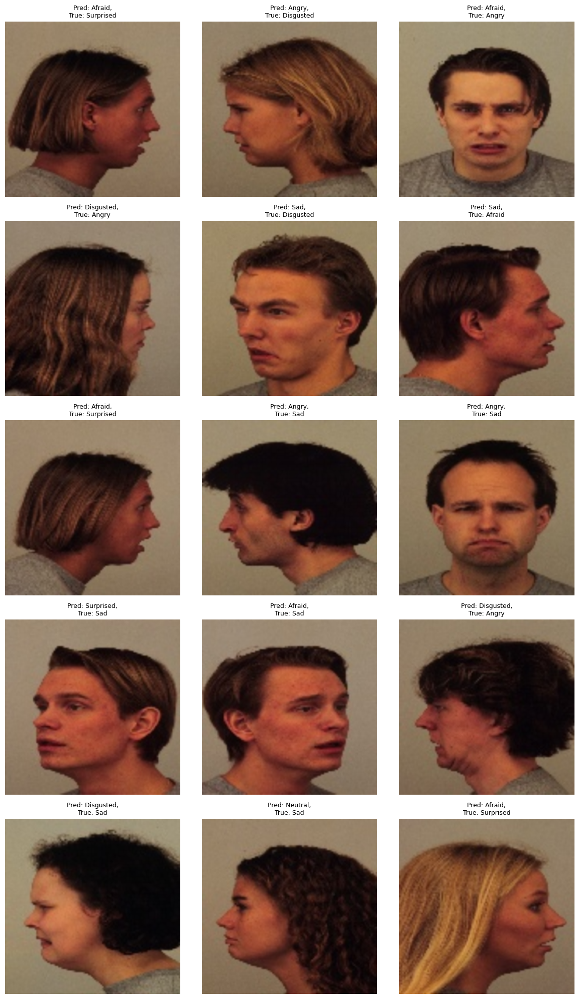




------------------------------------
 Accuracies  [0.9387755102040817, 0.9510204081632654, 0.9346938775510205, 0.9224489795918368, 0.9551020408163267, 0.9448979591836736, 0.9265306122448981]



Epoch 0/19
----------


100%|██████████| 138/138 [00:13<00:00,  9.90it/s]


train Loss: 1.5878 Acc: 0.3805


100%|██████████| 16/16 [00:01<00:00, 15.47it/s]


val Loss: 0.9753 Acc: 0.6429

Epoch 1/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.12it/s]


train Loss: 0.6787 Acc: 0.7599


100%|██████████| 16/16 [00:01<00:00, 14.66it/s]


val Loss: 0.6053 Acc: 0.7571

Epoch 2/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.05it/s]


train Loss: 0.3518 Acc: 0.8841


100%|██████████| 16/16 [00:01<00:00, 15.49it/s]


val Loss: 0.5801 Acc: 0.8143

Epoch 3/19
----------


100%|██████████| 138/138 [00:13<00:00,  9.99it/s]


train Loss: 0.2092 Acc: 0.9308


100%|██████████| 16/16 [00:01<00:00, 14.86it/s]


val Loss: 0.3503 Acc: 0.8980

Epoch 4/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.03it/s]


train Loss: 0.1593 Acc: 0.9456


100%|██████████| 16/16 [00:01<00:00, 14.99it/s]


val Loss: 0.4666 Acc: 0.8429

Epoch 5/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.15it/s]


train Loss: 0.0851 Acc: 0.9778


100%|██████████| 16/16 [00:01<00:00, 15.41it/s]


val Loss: 0.2318 Acc: 0.9143

Epoch 6/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.00it/s]


train Loss: 0.0673 Acc: 0.9810


100%|██████████| 16/16 [00:01<00:00, 14.91it/s]


val Loss: 0.2165 Acc: 0.9306

Epoch 7/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.06it/s]


train Loss: 0.0640 Acc: 0.9855


100%|██████████| 16/16 [00:01<00:00, 15.88it/s]


val Loss: 0.2244 Acc: 0.9245

Epoch 8/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.22it/s]


train Loss: 0.0543 Acc: 0.9871


100%|██████████| 16/16 [00:01<00:00, 15.49it/s]


val Loss: 0.2214 Acc: 0.9306

Epoch 9/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.33it/s]


train Loss: 0.0469 Acc: 0.9925


100%|██████████| 16/16 [00:01<00:00, 15.66it/s]


val Loss: 0.2252 Acc: 0.9224

Epoch 10/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.30it/s]


train Loss: 0.0483 Acc: 0.9905


100%|██████████| 16/16 [00:01<00:00, 14.54it/s]


val Loss: 0.2052 Acc: 0.9224

Epoch 11/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.22it/s]


train Loss: 0.0400 Acc: 0.9927


100%|██████████| 16/16 [00:01<00:00, 14.81it/s]


val Loss: 0.2052 Acc: 0.9245

Epoch 12/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.21it/s]


train Loss: 0.0404 Acc: 0.9912


100%|██████████| 16/16 [00:01<00:00, 15.62it/s]


val Loss: 0.2041 Acc: 0.9184

Epoch 13/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.25it/s]


train Loss: 0.0411 Acc: 0.9923


100%|██████████| 16/16 [00:01<00:00, 15.00it/s]


val Loss: 0.2023 Acc: 0.9245

Epoch 14/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.06it/s]


train Loss: 0.0379 Acc: 0.9925


100%|██████████| 16/16 [00:01<00:00, 15.91it/s]


val Loss: 0.2038 Acc: 0.9306

Epoch 15/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.30it/s]


train Loss: 0.0440 Acc: 0.9916


100%|██████████| 16/16 [00:01<00:00, 15.82it/s]


val Loss: 0.2208 Acc: 0.9245

Epoch 16/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.23it/s]


train Loss: 0.0430 Acc: 0.9921


100%|██████████| 16/16 [00:01<00:00, 15.63it/s]


val Loss: 0.2029 Acc: 0.9286

Epoch 17/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.19it/s]


train Loss: 0.0421 Acc: 0.9923


100%|██████████| 16/16 [00:01<00:00, 15.21it/s]


val Loss: 0.1994 Acc: 0.9306

Epoch 18/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.13it/s]


train Loss: 0.0397 Acc: 0.9921


100%|██████████| 16/16 [00:01<00:00, 15.39it/s]


val Loss: 0.2044 Acc: 0.9306

Epoch 19/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.20it/s]


train Loss: 0.0397 Acc: 0.9916


100%|██████████| 16/16 [00:01<00:00, 15.72it/s]


val Loss: 0.2171 Acc: 0.9163

Training complete in 4m 55s
Best val Acc: 0.930612
Showing misclassified examples for fold 7...


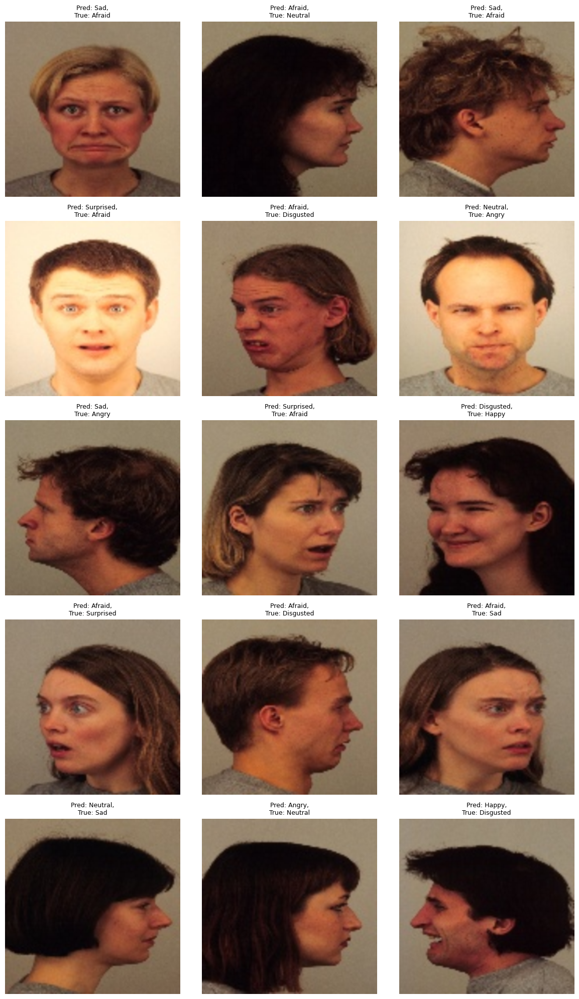




------------------------------------
 Accuracies  [0.9387755102040817, 0.9510204081632654, 0.9346938775510205, 0.9224489795918368, 0.9551020408163267, 0.9448979591836736, 0.9265306122448981, 0.9306122448979592]



Epoch 0/19
----------


100%|██████████| 138/138 [00:13<00:00,  9.93it/s]


train Loss: 1.5868 Acc: 0.3893


100%|██████████| 16/16 [00:01<00:00, 13.92it/s]


val Loss: 1.0390 Acc: 0.5980

Epoch 1/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.36it/s]


train Loss: 0.6875 Acc: 0.7551


100%|██████████| 16/16 [00:01<00:00, 15.11it/s]


val Loss: 0.5554 Acc: 0.8000

Epoch 2/19
----------


100%|██████████| 138/138 [00:14<00:00,  9.77it/s]


train Loss: 0.3409 Acc: 0.8862


100%|██████████| 16/16 [00:01<00:00, 14.87it/s]


val Loss: 0.4656 Acc: 0.8265

Epoch 3/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.15it/s]


train Loss: 0.2368 Acc: 0.9168


100%|██████████| 16/16 [00:01<00:00, 15.53it/s]


val Loss: 0.3695 Acc: 0.8612

Epoch 4/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.21it/s]


train Loss: 0.1613 Acc: 0.9456


100%|██████████| 16/16 [00:01<00:00, 15.83it/s]


val Loss: 0.3935 Acc: 0.8449

Epoch 5/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.13it/s]


train Loss: 0.0899 Acc: 0.9757


100%|██████████| 16/16 [00:01<00:00, 15.72it/s]


val Loss: 0.2446 Acc: 0.9163

Epoch 6/19
----------


100%|██████████| 138/138 [00:13<00:00,  9.90it/s]


train Loss: 0.0735 Acc: 0.9825


100%|██████████| 16/16 [00:01<00:00, 13.69it/s]


val Loss: 0.2305 Acc: 0.9102

Epoch 7/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.00it/s]


train Loss: 0.0582 Acc: 0.9875


100%|██████████| 16/16 [00:01<00:00, 15.66it/s]


val Loss: 0.2246 Acc: 0.9224

Epoch 8/19
----------


100%|██████████| 138/138 [00:13<00:00,  9.88it/s]


train Loss: 0.0532 Acc: 0.9889


100%|██████████| 16/16 [00:01<00:00, 15.56it/s]


val Loss: 0.2295 Acc: 0.9143

Epoch 9/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.22it/s]


train Loss: 0.0514 Acc: 0.9891


100%|██████████| 16/16 [00:01<00:00, 15.71it/s]


val Loss: 0.2365 Acc: 0.9163

Epoch 10/19
----------


100%|██████████| 138/138 [00:13<00:00,  9.97it/s]


train Loss: 0.0461 Acc: 0.9907


100%|██████████| 16/16 [00:01<00:00, 14.76it/s]


val Loss: 0.2276 Acc: 0.9143

Epoch 11/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.31it/s]


train Loss: 0.0439 Acc: 0.9905


100%|██████████| 16/16 [00:01<00:00, 15.34it/s]


val Loss: 0.2211 Acc: 0.9102

Epoch 12/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.22it/s]


train Loss: 0.0434 Acc: 0.9912


100%|██████████| 16/16 [00:01<00:00, 15.43it/s]


val Loss: 0.2302 Acc: 0.9184

Epoch 13/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.20it/s]


train Loss: 0.0444 Acc: 0.9916


100%|██████████| 16/16 [00:01<00:00, 15.34it/s]


val Loss: 0.2215 Acc: 0.9143

Epoch 14/19
----------


100%|██████████| 138/138 [00:14<00:00,  9.85it/s]


train Loss: 0.0429 Acc: 0.9918


100%|██████████| 16/16 [00:01<00:00, 14.83it/s]


val Loss: 0.2275 Acc: 0.9163

Epoch 15/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.08it/s]


train Loss: 0.0417 Acc: 0.9921


100%|██████████| 16/16 [00:01<00:00, 15.69it/s]


val Loss: 0.2239 Acc: 0.9204

Epoch 16/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.30it/s]


train Loss: 0.0413 Acc: 0.9921


100%|██████████| 16/16 [00:01<00:00, 15.62it/s]


val Loss: 0.2211 Acc: 0.9163

Epoch 17/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.11it/s]


train Loss: 0.0405 Acc: 0.9923


100%|██████████| 16/16 [00:01<00:00, 13.74it/s]


val Loss: 0.2163 Acc: 0.9204

Epoch 18/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.31it/s]


train Loss: 0.0446 Acc: 0.9907


100%|██████████| 16/16 [00:01<00:00, 15.48it/s]


val Loss: 0.2251 Acc: 0.9163

Epoch 19/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.18it/s]


train Loss: 0.0402 Acc: 0.9943


100%|██████████| 16/16 [00:01<00:00, 15.73it/s]


val Loss: 0.2226 Acc: 0.9143

Training complete in 4m 56s
Best val Acc: 0.922449
Showing misclassified examples for fold 8...


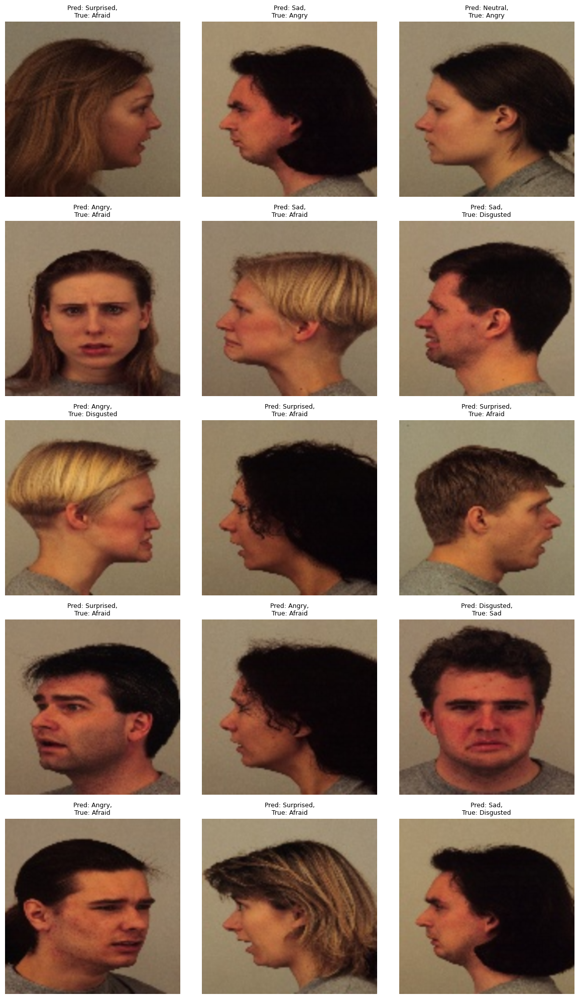




------------------------------------
 Accuracies  [0.9387755102040817, 0.9510204081632654, 0.9346938775510205, 0.9224489795918368, 0.9551020408163267, 0.9448979591836736, 0.9265306122448981, 0.9306122448979592, 0.9224489795918368]



Epoch 0/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.05it/s]


train Loss: 1.5805 Acc: 0.3837


100%|██████████| 16/16 [00:01<00:00, 14.98it/s]


val Loss: 0.9982 Acc: 0.6122

Epoch 1/19
----------


100%|██████████| 138/138 [00:13<00:00,  9.95it/s]


train Loss: 0.6825 Acc: 0.7540


100%|██████████| 16/16 [00:01<00:00, 15.76it/s]


val Loss: 0.5147 Acc: 0.8143

Epoch 2/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.26it/s]


train Loss: 0.3817 Acc: 0.8687


100%|██████████| 16/16 [00:01<00:00, 15.58it/s]


val Loss: 0.4671 Acc: 0.8265

Epoch 3/19
----------


100%|██████████| 138/138 [00:13<00:00,  9.99it/s]


train Loss: 0.2258 Acc: 0.9229


100%|██████████| 16/16 [00:01<00:00, 15.55it/s]


val Loss: 0.4241 Acc: 0.8429

Epoch 4/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.18it/s]


train Loss: 0.1477 Acc: 0.9503


100%|██████████| 16/16 [00:01<00:00, 15.37it/s]


val Loss: 0.5037 Acc: 0.8265

Epoch 5/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.32it/s]


train Loss: 0.1010 Acc: 0.9723


100%|██████████| 16/16 [00:01<00:00, 15.23it/s]


val Loss: 0.2109 Acc: 0.9245

Epoch 6/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.21it/s]


train Loss: 0.0692 Acc: 0.9832


100%|██████████| 16/16 [00:01<00:00, 15.32it/s]


val Loss: 0.2079 Acc: 0.9245

Epoch 7/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.26it/s]


train Loss: 0.0541 Acc: 0.9889


100%|██████████| 16/16 [00:01<00:00, 13.97it/s]


val Loss: 0.2010 Acc: 0.9327

Epoch 8/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.25it/s]


train Loss: 0.0489 Acc: 0.9891


100%|██████████| 16/16 [00:01<00:00, 15.78it/s]


val Loss: 0.1957 Acc: 0.9327

Epoch 9/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.00it/s]


train Loss: 0.0483 Acc: 0.9902


100%|██████████| 16/16 [00:01<00:00, 15.60it/s]


val Loss: 0.1931 Acc: 0.9327

Epoch 10/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.22it/s]


train Loss: 0.0440 Acc: 0.9902


100%|██████████| 16/16 [00:01<00:00, 15.63it/s]


val Loss: 0.1847 Acc: 0.9327

Epoch 11/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.09it/s]


train Loss: 0.0411 Acc: 0.9927


100%|██████████| 16/16 [00:01<00:00, 14.39it/s]


val Loss: 0.1915 Acc: 0.9327

Epoch 12/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.23it/s]


train Loss: 0.0456 Acc: 0.9907


100%|██████████| 16/16 [00:01<00:00, 15.64it/s]


val Loss: 0.1892 Acc: 0.9327

Epoch 13/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.04it/s]


train Loss: 0.0400 Acc: 0.9925


100%|██████████| 16/16 [00:01<00:00, 14.55it/s]


val Loss: 0.1847 Acc: 0.9367

Epoch 14/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.25it/s]


train Loss: 0.0384 Acc: 0.9932


100%|██████████| 16/16 [00:01<00:00, 15.62it/s]


val Loss: 0.1840 Acc: 0.9347

Epoch 15/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.00it/s]


train Loss: 0.0395 Acc: 0.9921


100%|██████████| 16/16 [00:01<00:00, 14.09it/s]


val Loss: 0.1882 Acc: 0.9347

Epoch 16/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.28it/s]


train Loss: 0.0404 Acc: 0.9907


100%|██████████| 16/16 [00:01<00:00, 15.04it/s]


val Loss: 0.1871 Acc: 0.9347

Epoch 17/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.23it/s]


train Loss: 0.0345 Acc: 0.9943


100%|██████████| 16/16 [00:01<00:00, 15.82it/s]


val Loss: 0.1921 Acc: 0.9347

Epoch 18/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.02it/s]


train Loss: 0.0381 Acc: 0.9932


100%|██████████| 16/16 [00:01<00:00, 14.78it/s]


val Loss: 0.1957 Acc: 0.9408

Epoch 19/19
----------


100%|██████████| 138/138 [00:13<00:00, 10.18it/s]


train Loss: 0.0406 Acc: 0.9912


100%|██████████| 16/16 [00:01<00:00, 14.87it/s]


val Loss: 0.1886 Acc: 0.9327

Training complete in 4m 55s
Best val Acc: 0.940816
Showing misclassified examples for fold 9...


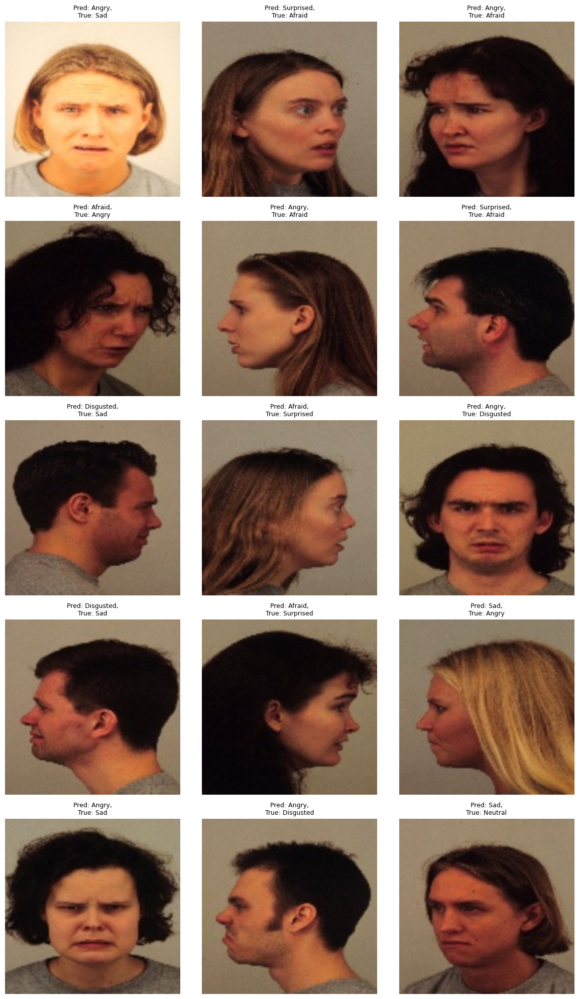




------------------------------------
 Accuracies  [0.9387755102040817, 0.9510204081632654, 0.9346938775510205, 0.9224489795918368, 0.9551020408163267, 0.9448979591836736, 0.9265306122448981, 0.9306122448979592, 0.9224489795918368, 0.9408163265306123]





In [22]:
accuracies = []
index = list(np.random.permutation(4900))

for i in range(10):
    idx = {
        'val': index[490 * i:490 * (i + 1)],
        'train': index[:i * 490] + index[((i + 1) * 490):]
    }

    dataloaders = {
        x: torch.utils.data.DataLoader(
            KDEFDataset(transforms_=data_transforms[x], idx=idx[x]),
            batch_size=32,
            shuffle=True
        )
        for x in ['train', 'val']
    }

    model_ft = models.resnet50(weights='IMAGENET1K_V1')
    num_ftrs = model_ft.fc.in_features
    model_ft.fc = nn.Linear(num_ftrs, class_names)
    model_ft = model_ft.to(device)

    criterion = nn.CrossEntropyLoss()
    optimizer_ft = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)
    exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=6, gamma=0.1)

    logdir = f'./logs/resnet50_kfold_{i}'
    os.makedirs(logdir, exist_ok=True)  # Ensure logs dir exists
    writer = SummaryWriter(logdir)

    # 🛠️ ensure "saved" directory exists before saving the model
    os.makedirs('saved', exist_ok=True)

    model_ft, best_acc = train_model(
        model_ft,
        criterion,
        optimizer_ft,
        exp_lr_scheduler,
        dataloaders,
        writer,
        i,
        num_epochs=20
    )

    # Save model
    torch.save(model_ft.state_dict(), f'saved/model_fold_{i}.pt')

    print(f"Showing misclassified examples for fold {i}...")
    visualize_model_misclassified(
    model=model_ft,
    dataloader=dataloaders['val'],
    class_names={
        0: "Afraid", 1: "Angry", 2: "Disgusted",
        3: "Happy", 4: "Neutral", 5: "Sad", 6: "Surprised"
    },
    save_dir=f'misclassified/fold_{i}',
    num_images=15,

)

    accuracies.append(float(best_acc.cpu().numpy()))
    print("\n\n\n------------------------------------\n Accuracies ", accuracies)
    print("\n\n")



In [23]:
from google.colab import files

!zip -r resnet50_112x112_logs_and_saved_misclassified.zip logs saved misclassified
files.download('resnet50_112x112_logs_and_saved_misclassified.zip')

  adding: logs/ (stored 0%)
  adding: logs/resnet50_kfold_8/ (stored 0%)
  adding: logs/resnet50_kfold_8/events.out.tfevents.1744894783.1823d2bb5fc6 (deflated 62%)
  adding: logs/resnet50_kfold_2/ (stored 0%)
  adding: logs/resnet50_kfold_2/events.out.tfevents.1744893002.1823d2bb5fc6 (deflated 62%)
  adding: logs/resnet50_kfold_5/ (stored 0%)
  adding: logs/resnet50_kfold_5/events.out.tfevents.1744893886.1823d2bb5fc6 (deflated 62%)
  adding: logs/resnet50_kfold_4/ (stored 0%)
  adding: logs/resnet50_kfold_4/events.out.tfevents.1744893591.1823d2bb5fc6 (deflated 62%)
  adding: logs/resnet50_kfold_9/ (stored 0%)
  adding: logs/resnet50_kfold_9/events.out.tfevents.1744895082.1823d2bb5fc6 (deflated 61%)
  adding: logs/resnet50_kfold_6/ (stored 0%)
  adding: logs/resnet50_kfold_6/events.out.tfevents.1744894184.1823d2bb5fc6 (deflated 62%)
  adding: logs/resnet50_kfold_3/ (stored 0%)
  adding: logs/resnet50_kfold_3/events.out.tfevents.1744893296.1823d2bb5fc6 (deflated 62%)
  adding: logs/resne

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>